In [1]:
import pandas as pd
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from math import ceil
import pandas as pd
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import MinMaxScaler
import time
from sklearn.model_selection import KFold
import seaborn as sns
# from sklearn.model_selection import train_test_split

In [2]:

# # !pip install pandas numpy matplotlib plotly scikit-learn seaborn
# !pip install mord 

# LOAD AND PREPARE DATA

Test Dataset 1

In [3]:
# # Load and clean data
# data = pd.read_csv("traffic_crashes_people.csv")
# data = data.drop(['physical_condition', 'airbag_deployed', 'ejection'], axis=1)
# # Random sample 8,000 rows using seed 1337
# data = data.dropna().reset_index(drop=True)
# data = data.sample(n=25000, random_state=1337)
# target = 'injury_classification'
# data.head()

Test Dataset 2

In [4]:
# # Cleanning Method 2 ================================
# data = pd.read_table('fruit_data_with_colors.txt')
# data = data.dropna().drop(columns=['fruit_subtype', 'fruit_label'])
# target = "fruit_name"
# data.head()


Test Dataset 3

In [5]:
# Load and clean data
data_raw = pd.read_csv("F1_main_data_v9.csv")
data = data_raw.copy()
# data = data.drop(['physical_condition', 'airbag_deployed', 'ejection'], axis=1)
# Random sample 8,000 rows using seed 1337
# data = data.dropna().reset_index(drop=True)
# data = data.sample(n=25000, random_state=1337)
# data=data.drop(columns=["Timestamp","driver_code","GrandPrix","team","Consistency_Race", "Style_Race",
#                         "Technical_Race","Pace_Race","PerformanceIndex_Race"])
data=data.drop(columns=["Timestamp","driver_code","GrandPrix","Consistency_Race", "Style_Race",
                        "Technical_Race","Pace_Race","PerformanceIndex_Race","driver_points","team_points"])
target = 'RaceFinishPosition'
data.head()

,Consistency_Qual,Style_Qual,Technical_Qual,Pace_Qual,PerformanceIndex_Qual,Round,year,QualifyingPosition,RaceFinishPosition,team,...,Finish_pct,Accident_pct,Collision_pct,Damage Related_pct,DNF_pct,Race_Complexity_Score,Safety_Index,mechanical_faults,avg_stops_per_car_race,avg_pitstop_ms
0,0.254063,0.202593,0.403174,0.80,0.414957,12,2025,5,4.0,Ferrari,...,84.415584,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215
1,0.000000,0.199975,0.305004,0.75,0.313745,12,2025,6,14.0,Ferrari,...,84.415584,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215
2,0.168950,0.500000,0.417430,0.90,0.496595,12,2025,3,1.0,McLaren,...,84.415584,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215
3,0.340871,0.202912,0.190251,0.95,0.421008,12,2025,2,2.0,McLaren,...,84.415584,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215
4,0.463925,0.792030,0.231651,0.85,0.584402,12,2025,4,10.0,Mercedes,...,84.415584,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215


In [6]:
data.shape

(726, 30)

# PROCESS DATA

MODIFIED Race Finish Position as Ordinal Values

In [7]:
# # METHOD 1 What Position ==========================================
# # Converting Race Finish Output to Integer Values
# # data2.loc[:, "RaceFinishPosition"] = data2["RaceFinishPosition"].astype(int)
# data["RaceFinishPosition"] = pd.to_numeric(data["RaceFinishPosition"], errors="coerce").fillna(0).astype(int)


# # METHOD 2 Podium vs No Podium ==========================================
# # Convert to numeric safely
# data["RaceFinishPosition"] = pd.to_numeric(data["RaceFinishPosition"], errors="coerce")

# # Classify: 1 if Podium (positions 1, 2, 3), 0 otherwise
# data["RaceFinishPosition"] = np.where(data["RaceFinishPosition"].between(1, 3), 1, 0)

# # METHOD 3 1st place or None ==========================================
# # Convert to numeric safely
# data["RaceFinishPosition"] = pd.to_numeric(data["RaceFinishPosition"], errors="coerce")

# # Classify: 1 if Podium (positions 1, 2, 3), 0 otherwise
# data["RaceFinishPosition"] = np.where(data["RaceFinishPosition"].between(1, 1), 1, 0)

# data["RaceFinishPosition"].head()

# METHOD 4. 4 Categories. 1st 2nd 3rd and No Podium =========================
# Convert to numeric safely
data["RaceFinishPosition"] = pd.to_numeric(data["RaceFinishPosition"], errors="coerce")

# 4 categories: 1st, 2nd, 3rd, no podium (0)
data["RaceFinishPosition"] = np.select(
    [
        data["RaceFinishPosition"] == 1,
        data["RaceFinishPosition"] == 2,
        data["RaceFinishPosition"] == 3,
    ],
    [1, 2, 3],
    default=0
)

data["RaceFinishPosition"].head()


0    0
1    0
2    1
3    2
4    0
Name: RaceFinishPosition, dtype: int64

Check Numerical and Categorical Columns  

In [8]:
# Identify categorical and numeric columns
cat_cols = data.select_dtypes(include=['object', 'category']).columns
num_cols = data.select_dtypes(exclude=['object', 'category']).columns

print("Numeric columns:", num_cols.tolist())
print("Categorical columns:", cat_cols.tolist())

# --- Check for missing values ---
missing_info = data.isna().sum()  # count NaN per column
missing_info = missing_info[missing_info > 0]  # only show columns with NaN

if not missing_info.empty:
    print("\n🧩 Columns with missing values:")
    print(missing_info.sort_values(ascending=False))
else:
    print("\n✅ No missing values found in the dataset!")

# Fill all numeric columns with their mean
data[num_cols] = data[num_cols].apply(lambda x: x.fillna(x.mean()))

# (Optional) For categorical columns, you can fill NaN with a placeholder
data[cat_cols] = data[cat_cols].fillna("Unknown")

# Verify if any NaN remain
print("\nRemaining missing values after mean imputation:")
print(data.isna().sum()[data.isna().sum() > 0])



Numeric columns: ['Consistency_Qual', 'Style_Qual', 'Technical_Qual', 'Pace_Qual', 'PerformanceIndex_Qual', 'Round', 'year', 'QualifyingPosition', 'RaceFinishPosition', 'Laps', 'Corners', 'Circuit length (km)', 'Race distance (km)', 'Accident', 'Collision', 'Damage Related', 'Finish', 'Total_Entries', 'Finish_pct', 'Accident_pct', 'Collision_pct', 'Damage Related_pct', 'DNF_pct', 'Race_Complexity_Score', 'Safety_Index', 'mechanical_faults', 'avg_stops_per_car_race', 'avg_pitstop_ms']
Categorical columns: ['team', 'Direction']

🧩 Columns with missing values:
PerformanceIndex_Qual    2
Consistency_Qual         1
Style_Qual               1
dtype: int64

Remaining missing values after mean imputation:
Series([], dtype: int64)


One Hot Encoding

In [9]:
X = data.drop(columns=[target])
y = data[target]

# Separate categorical and numeric columns
cat_cols = X.select_dtypes(include=['object', 'category']).columns
num_cols = X.select_dtypes(exclude=['object', 'category']).columns.tolist()

# Only build encoder if categorical columns exist
if len(cat_cols) > 0:
    ohe = OneHotEncoder(
        handle_unknown='infrequent_if_exist',
        min_frequency=0.01,   # ~1% threshold for infrequent categories
        sparse_output=False,
        dtype=int              # ensures 0/1 not True/False
    )

    preprocessor = ColumnTransformer(
        transformers=[
            ('cat', ohe, cat_cols),
            ('num', 'passthrough', num_cols)
        ],
        remainder='drop'
    )

    # ⚠️ Use fit_transform only the first time
    X_encoded = preprocessor.fit_transform(X)
    feature_names = preprocessor.get_feature_names_out()
else:
    X_encoded = X.values
    feature_names = X.columns

data2 = pd.DataFrame(X_encoded, columns=feature_names)

# Attach target
data2 = pd.concat([data2, y.reset_index(drop=True)], axis=1)

data2.head()

,cat__team_Alpine Renault,cat__team_Aston Martin Aramco Mercedes,cat__team_Ferrari,cat__team_McLaren,cat__team_McLaren Mercedes,cat__team_McLaren Renault,cat__team_Mercedes,cat__team_Red Bull Racing,cat__team_Red Bull Racing Honda,cat__team_Red Bull Racing Honda RBPT,...,num__Accident_pct,num__Collision_pct,num__Damage Related_pct,num__DNF_pct,num__Race_Complexity_Score,num__Safety_Index,num__mechanical_faults,num__avg_stops_per_car_race,num__avg_pitstop_ms,RaceFinishPosition
0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215,0
1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215,0
2,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215,1
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215,2
4,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215,0


# SPLIT TRAIN, VAIDATION, TEST

### SELECT TEST DATA

METHOD 1  
Last rows as test data. Best for Time Series

In [10]:
# # Separate features and target
# X = data2.drop(columns=[target])
# y = data2[target]
# num_latest_data = int(len(X)*0.05)
# # Final test: last 1000 rows (keep deterministic)
# X_test = X.tail(num_latest_data)
# y_test = y.tail(num_latest_data)

# # Remaining data
# X_train_val = X.iloc[:-num_latest_data]
# y_train_val = y.iloc[:-num_latest_data]

# print(f"Train and Val size: {len(X_train_val)} rows ({len(X_train_val)/len(X)*100:.1f}%)")
# print(f"Test size: {len(X_test)} rows ({len(X_test)/len(X)*100:.1f}%)")


METHOD 2  
General Method

In [11]:
# X = data2.drop(columns=[target])
# y = data2[target]

# # --- Step 1: Split into Train (70%) and Temp (30%) ---
# X_train_val, X_test, y_train_val, y_test = train_test_split(
#     X, y,
#     test_size=0.05,           # 30% for val+test
#     random_state=42,         # reproducibility
#     stratify=None            # set to y if classification
# )

# print(f"Train and Val size: {len(X_train_val)} rows ({len(X_train_val)/len(X)*100:.1f}%)")
# print(f"Test size: {len(X_test)} rows ({len(X_test)/len(X)*100:.1f}%)")

METHOD 3  
Future Predicting 2025 Data

In [12]:
data2.head()

,cat__team_Alpine Renault,cat__team_Aston Martin Aramco Mercedes,cat__team_Ferrari,cat__team_McLaren,cat__team_McLaren Mercedes,cat__team_McLaren Renault,cat__team_Mercedes,cat__team_Red Bull Racing,cat__team_Red Bull Racing Honda,cat__team_Red Bull Racing Honda RBPT,...,num__Accident_pct,num__Collision_pct,num__Damage Related_pct,num__DNF_pct,num__Race_Complexity_Score,num__Safety_Index,num__mechanical_faults,num__avg_stops_per_car_race,num__avg_pitstop_ms,RaceFinishPosition
0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215,0
1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215,0
2,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215,1
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215,2
4,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,3.896104,11.688312,0.0,15.584416,0.491688,0.352468,0.0,1.89162,160011.280215,0


In [13]:
# ✅ Split dataset by year
train_val_data = data2[data2["num__year"] < 2025].copy()    # all years before 2025
data_2025 = data2[data2["num__year"] == 2025].copy()        # only 2025 data

# --- Control what % of 2025 data to use for test ---
test_fraction = 0.99 # 👈 set this to the % (e.g., 0.3 = 30%, 0.5 = 50%)

data_2025_train, data_2025_test = train_test_split(
    data_2025,
    test_size=test_fraction,
    random_state=42,     # reproducibility
    shuffle=True         # shuffle so random subset of 2025 data
)

# Combine all training data (pre-2025 + part of 2025)
train_val_data = pd.concat([train_val_data, data_2025_train], ignore_index=True)
test_data = data_2025_test.copy()

# Define features and target
X_train_val = train_val_data.drop(columns=[target])
y_train_val = train_val_data[target]

X_test = test_data.drop(columns=[target])
y_test = test_data[target]

# --- Display summary ---
print(f"Training + Validation size: {len(X_train_val)} rows ({len(X_train_val)/len(data2)*100:.1f}%)")
print(f"Test size ({test_fraction*100:.0f}% of 2025 data): {len(X_test)} rows ({len(X_test)/len(data2)*100:.1f}%)")


Training + Validation size: 601 rows (82.8%)
Test size (99% of 2025 data): 125 rows (17.2%)


In [14]:
X_test.head()

,cat__team_Alpine Renault,cat__team_Aston Martin Aramco Mercedes,cat__team_Ferrari,cat__team_McLaren,cat__team_McLaren Mercedes,cat__team_McLaren Renault,cat__team_Mercedes,cat__team_Red Bull Racing,cat__team_Red Bull Racing Honda,cat__team_Red Bull Racing Honda RBPT,...,num__Finish_pct,num__Accident_pct,num__Collision_pct,num__Damage Related_pct,num__DNF_pct,num__Race_Complexity_Score,num__Safety_Index,num__mechanical_faults,num__avg_stops_per_car_race,num__avg_pitstop_ms
73,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,86.274510,2.941176,10.784314,0.0,13.725490,0.414510,0.448235,0.0,1.89162,160011.280215
19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,94.117647,1.176471,4.705882,0.0,5.882353,0.277647,0.663529,0.0,1.89162,160011.280215
116,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,85.600000,6.400000,8.000000,0.0,14.400000,0.478000,0.378000,0.0,1.89162,160011.280215
67,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,88.541667,1.041667,10.416667,0.0,11.458333,0.369167,0.516250,0.0,1.89162,160011.280215
94,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,87.378641,3.883495,8.737864,0.0,12.621359,0.392427,0.481359,0.0,1.89162,160011.280215


### SELECT VALIDATION DATA

METHOD 1  
General method with Sklearn

In [15]:
X = X_train_val.copy()
y = y_train_val.copy()

# --- Step 1: Split into Train (70%) and Temp (30%) ---
X_train, X_val, y_train, y_val = train_test_split(
    X, y,
    test_size=0.10,           # 30% for val+test
    random_state=42,         # reproducibility
    stratify=None            # set to y if classification
)

print(f"Train and Val size: {len(X_train)} rows ({len(X_train)/len(X)*100:.1f}%)")
print(f"Test size: {len(X_val)} rows ({len(X_val)/len(X)*100:.1f}%)")

Train and Val size: 540 rows (89.9%)
Test size: 61 rows (10.1%)


### DATA SCALING

In [16]:
# # scaler = StandardScaler()
# scaler = MinMaxScaler()
# X_train_scaled = scaler.fit_transform(X_train)   # fit on TRAIN only
# X_val_scaled   = scaler.transform(X_val)         # transform VAL with same scaler
# X_test_scaled  = scaler.transform(X_test)     

# ML MODELLING

Default Settings. Single Run. No Hyperparameter Tuning

In [17]:
X_train.head()

,cat__team_Alpine Renault,cat__team_Aston Martin Aramco Mercedes,cat__team_Ferrari,cat__team_McLaren,cat__team_McLaren Mercedes,cat__team_McLaren Renault,cat__team_Mercedes,cat__team_Red Bull Racing,cat__team_Red Bull Racing Honda,cat__team_Red Bull Racing Honda RBPT,...,num__Finish_pct,num__Accident_pct,num__Collision_pct,num__Damage Related_pct,num__DNF_pct,num__Race_Complexity_Score,num__Safety_Index,num__mechanical_faults,num__avg_stops_per_car_race,num__avg_pitstop_ms
176,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,86.885246,4.918033,8.196721,0.000000,13.114754,0.532295,0.336557,0.0,1.891620,160011.280215
329,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,93.388430,0.826446,5.785124,0.000000,6.611570,0.282231,0.651653,0.0,1.891620,160011.280215
536,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,90.625000,0.000000,8.333333,1.041667,9.375000,0.287500,0.618750,5.0,1.612903,183825.400000
548,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,87.378641,3.883495,8.737864,0.000000,12.621359,0.392427,0.481359,0.0,1.891620,160011.280215
70,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,84.415584,3.896104,11.688312,0.000000,15.584416,0.491688,0.352468,0.0,1.891620,160011.280215


In [18]:
# --- imports ---
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from lightgbm import LGBMClassifier
import xgboost as xgb
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.pipeline import make_pipeline
import pandas as pd

# NEW: import an ordinal classifier
# !pip install mord --quiet
import mord as m  # Mord implements ordinal logistic regression (LogisticIT, OrdinalRidge, etc.)

# --- define models (pipelines where scaling helps) ---
pipe_lr  = make_pipeline(MinMaxScaler(), LogisticRegression(max_iter=10000))
pipe_knn = make_pipeline(MinMaxScaler(), KNeighborsClassifier())
pipe_svm = make_pipeline(MinMaxScaler(), SVC())
pipe_nb  = make_pipeline(MinMaxScaler(), GaussianNB())

DT  = DecisionTreeClassifier()
RF  = RandomForestClassifier()
GBM = GradientBoostingClassifier()
LGB = LGBMClassifier(verbose=-1)

# NEW: Ordinal Logistic Regression model (LogisticIT)
ORD = make_pipeline(MinMaxScaler(), m.LogisticIT())  # cumulative link model

# --- XGBoost requires encoded y ---
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train_enc = le.fit_transform(y_train)
y_val_enc   = le.transform(y_val)
y_test_enc  = le.transform(y_test)
XGB = xgb.XGBClassifier(verbosity=0, eval_metric='mlogloss')

# --- fit on X_train/y_train ---
ORD.fit(X_train, y_train)
pipe_lr.fit(X_train, y_train)
pipe_knn.fit(X_train, y_train)
pipe_svm.fit(X_train, y_train)
pipe_nb.fit(X_train, y_train)

DT.fit(X_train, y_train)
RF.fit(X_train, y_train)
GBM.fit(X_train, y_train)
LGB.fit(X_train, y_train)
XGB.fit(X_train, y_train_enc)

# --- evaluate models ---
round_val = 5
cols = ['Machine Learning Classification Method', 'Train Accuracy', 'Validation Accuracy']
df_result = pd.DataFrame(columns=cols)

df_result.loc[0] = ['Ordinal Logistic Regression (mord)', round(ORD.score(X_train, y_train), round_val), round(ORD.score(X_val, y_val), round_val)]
df_result.loc[1] = ['Logistic Regression', round(pipe_lr.score(X_train, y_train), round_val), round(pipe_lr.score(X_val, y_val), round_val)]
df_result.loc[2] = ['kNN', round(pipe_knn.score(X_train, y_train), round_val), round(pipe_knn.score(X_val, y_val), round_val)]
df_result.loc[3] = ['Decision Tree', round(DT.score(X_train, y_train), round_val), round(DT.score(X_val, y_val), round_val)]
df_result.loc[4] = ['Random Forest', round(RF.score(X_train, y_train), round_val), round(RF.score(X_val, y_val), round_val)]
df_result.loc[5] = ['Gradient Boosting', round(GBM.score(X_train, y_train), round_val), round(GBM.score(X_val, y_val), round_val)]
df_result.loc[6] = ['XGBoost', round(XGB.score(X_train, y_train_enc), round_val), round(XGB.score(X_val, y_val_enc), round_val)]
df_result.loc[7] = ['LightGBM', round(LGB.score(X_train, y_train), round_val), round(LGB.score(X_val, y_val), round_val)]
df_result.loc[8] = ['Support Vector Machine', round(pipe_svm.score(X_train, y_train), round_val), round(pipe_svm.score(X_val, y_val), round_val)]
df_result.loc[9] = ['Naive Bayes', round(pipe_nb.score(X_train, y_train), round_val), round(pipe_nb.score(X_val, y_val), round_val)]

df_result = df_result.sort_values(by='Validation Accuracy', ascending=False)
df_result


,Machine Learning Classification Method,Train Accuracy,Validation Accuracy
7,LightGBM,1.00000,0.78689
6,XGBoost,1.00000,0.77049
2,kNN,0.78889,0.75410
1,Logistic Regression,0.78519,0.75410
8,Support Vector Machine,0.76296,0.75410
0,Ordinal Logistic Regression (mord),0.73889,0.73770
4,Random Forest,1.00000,0.73770
5,Gradient Boosting,1.00000,0.73770
3,Decision Tree,1.00000,0.72131
9,Naive Bayes,0.34444,0.39344


ML Modelling: Single Run. Combining with Test Data

In [19]:
# table
cols = ['Machine Learning Classification Method','Train Accuracy','Validation Accuracy','Test Accuracy']
df_result2 = pd.DataFrame(columns=cols)
round_val = 8
df_result2.loc[0] = ['Logistic Regression', round(pipe_lr.score(X_train,y_train),round_val), round(pipe_lr.score(X_val,y_val),round_val), round(pipe_lr.score(X_test,y_test),round_val)]
df_result2.loc[1] = ['kNN', round(pipe_knn.score(X_train,y_train),round_val), round(pipe_knn.score(X_val,y_val),round_val), round(pipe_knn.score(X_test,y_test),round_val)]
df_result2.loc[2] = ['Decision Tree', round(DT.score(X_train,y_train),round_val), round(DT.score(X_val,y_val),round_val), round(DT.score(X_test,y_test),round_val)]
df_result2.loc[3] = ['Random Forest', round(RF.score(X_train,y_train),round_val), round(RF.score(X_val,y_val),round_val), round(RF.score(X_test,y_test),round_val)]
df_result2.loc[4] = ['Gradient Boosting', round(GBM.score(X_train,y_train),round_val), round(GBM.score(X_val,y_val),round_val), round(GBM.score(X_test,y_test),round_val)]
df_result2.loc[5] = ['XGBoost', round(XGB.score(X_train,y_train_enc),round_val), round(XGB.score(X_val,y_val_enc),round_val), round(XGB.score(X_test,y_test_enc),round_val)]
df_result2.loc[6] = ['LightGBM', round(LGB.score(X_train,y_train),round_val), round(LGB.score(X_val,y_val),round_val), round(LGB.score(X_test,y_test),round_val)]
df_result2.loc[7] = ['Support Vector Machine', round(pipe_svm.score(X_train,y_train),round_val), round(pipe_svm.score(X_val,y_val),round_val), round(pipe_svm.score(X_test,y_test),round_val)]
df_result2.loc[8] = ['Naive Bayes', round(pipe_nb.score(X_train,y_train),round_val), round(pipe_nb.score(X_val,y_val),round_val), round(pipe_nb.score(X_test,y_test),round_val)]

df_result2 = df_result2.sort_values(by='Validation Accuracy', ascending=False)
df_result2

,Machine Learning Classification Method,Train Accuracy,Validation Accuracy,Test Accuracy
6,LightGBM,1.000000,0.786885,0.648
5,XGBoost,1.000000,0.770492,0.648
0,Logistic Regression,0.785185,0.754098,0.600
1,kNN,0.788889,0.754098,0.632
7,Support Vector Machine,0.762963,0.754098,0.600
3,Random Forest,1.000000,0.737705,0.680
4,Gradient Boosting,1.000000,0.737705,0.632
2,Decision Tree,1.000000,0.721311,0.600
8,Naive Bayes,0.344444,0.393443,0.152


# HYPERPARMETER TUNING: GRID SEARCH

ALL MODELS

In [20]:
# ============================================================
# 🏎️ Machine Learning Training Framework with Ordinal + Test Eval
# ============================================================

import time
import numpy as np
import pandas as pd
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import KFold, cross_val_score
from skopt import BayesSearchCV
from skopt.space import Integer, Categorical, Real
from skopt.callbacks import DeadlineStopper

# === Classifiers ===
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
import xgboost as xgb
import mord as m
import ast

# ============================================================
# === Configuration ===
# ============================================================

cv = KFold(n_splits=3, shuffle=True, random_state=42)

# ============================================================
# === Helper functions ===
# ============================================================

def _final_estimator(est):
    """Return final estimator from pipeline or model."""
    return list(est.named_steps.values())[-1] if hasattr(est, "named_steps") else est

def _top_feature(estimator, X):
    """Return most important feature based on coefficients or importances."""
    est = _final_estimator(estimator)
    try:
        if hasattr(est, "feature_importances_"):
            idx = int(np.argmax(est.feature_importances_))
            return X.columns[idx]
        if hasattr(est, "coef_"):
            coef = np.asarray(est.coef_)
            if coef.ndim > 1:
                coef = np.mean(np.abs(coef), axis=0)
            idx = int(np.argmax(np.abs(coef)))
            return X.columns[idx]
    except Exception:
        pass
    return "NA"

# ============================================================
# === Core Training Function Template ===
# ============================================================

def _train_model(model_name, model, search_space, X, y, X_test, y_test):
    """Unified function for BayesSearchCV + test evaluation."""
    t0 = time.time()

    # Mord models skip BayesSearchCV since no params to tune
    if model_name == "Ordinal Logistic Regression (mord)":
        scores = cross_val_score(model, X, y, cv=cv, scoring="accuracy", n_jobs=-1)
        model.fit(X, y)
        test_score = model.score(X_test, y_test)
        return [
            model_name,
            scores.mean(),
            "{}",
            _top_feature(model, X),
            test_score,
            time.time() - t0,
        ]

    # Standard models with BayesSearchCV
    bayes = BayesSearchCV(model, search_space, n_iter=30, scoring="accuracy",
                          cv=cv, n_jobs=-1, random_state=42, verbose=0)
    bayes.fit(X, y, callback=[DeadlineStopper(60)])

    # Evaluate best model on test data
    best_model = bayes.best_estimator_
    test_score = best_model.score(X_test, y_test)

    return [
        model_name,
        bayes.best_score_,
        str(bayes.best_params_),
        _top_feature(best_model, X),
        test_score,
        time.time() - t0,
    ]

# ============================================================
# === Individual Model Functions ===
# ============================================================

def train_ordinal(X, y, X_test, y_test):
    model = make_pipeline(MinMaxScaler(), m.LogisticIT())
    return _train_model("Ordinal Logistic Regression (mord)", model, {}, X, y, X_test, y_test)

def train_logreg(X, y, X_test, y_test):
    pipe = make_pipeline(MinMaxScaler(), LogisticRegression(max_iter=10000))
    search = {
        "logisticregression__C": Real(1e-3, 1e3, prior="log-uniform"),
        "logisticregression__penalty": Categorical(["l2", "l1"]),
        "logisticregression__solver": Categorical(["liblinear", "saga"]),
    }
    return _train_model("Logistic Regression", pipe, search, X, y, X_test, y_test)

def train_knn(X, y, X_test, y_test):
    pipe = make_pipeline(MinMaxScaler(), KNeighborsClassifier())
    search = {
        "kneighborsclassifier__n_neighbors": Integer(1, 50),
        "kneighborsclassifier__weights": Categorical(["uniform", "distance"]),
        "kneighborsclassifier__p": Categorical([1, 2]),
    }
    return _train_model("kNN", pipe, search, X, y, X_test, y_test)

def train_dt(X, y, X_test, y_test):
    model = DecisionTreeClassifier(random_state=42)
    search = {
        "max_depth": Integer(2, 50),
        "min_samples_split": Integer(2, 20),
        "min_samples_leaf": Integer(1, 20),
        "max_features": Categorical([None, "sqrt", "log2"]),
    }
    return _train_model("Decision Tree", model, search, X, y, X_test, y_test)

def train_rf(X, y, X_test, y_test):
    model = RandomForestClassifier(random_state=42, n_jobs=-1)
    search = {
        "n_estimators": Integer(80, 200),
        "max_depth": Integer(2, 20),
        "max_features": Categorical(["sqrt", "log2"]),
        "bootstrap": Categorical([True, False]),
        
    }
    return _train_model("Random Forest", model, search, X, y, X_test, y_test)

def train_gbm(X, y, X_test, y_test):
    model = GradientBoostingClassifier(random_state=42)
    search = {
        "n_estimators": Integer(80, 200),
        "learning_rate": Real(1e-2, 0.3, prior="log-uniform"),
        "max_depth": Integer(2, 6),
        "subsample": Real(0.5, 1.0),
    }
    return _train_model("Gradient Boosting", model, search, X, y, X_test, y_test)

def train_xgb(X, y, X_test, y_test):
    model = xgb.XGBClassifier(random_state=42, nthread=-1, tree_method="hist",
                              use_label_encoder=False, eval_metric="logloss")
    search = {
        "n_estimators": Integer(100, 1000),
        "learning_rate": Real(1e-3, 0.3, prior="log-uniform"),
        "max_depth": Integer(2, 10),
        "subsample": Real(0.5, 1.0),
        "colsample_bytree": Real(0.5, 1.0),
        "reg_lambda": Real(1e-3, 15.0, prior="log-uniform"),
        "reg_alpha": Real(1e-6, 1.0, prior="log-uniform"),
    }
    return _train_model("XGBoost", model, search, X, y, X_test, y_test)

def train_lgb(X, y, X_test, y_test):
    model = LGBMClassifier(random_state=42, n_jobs=-1)
    search = {
        "n_estimators": Integer(200, 1200),
        "learning_rate": Real(1e-3, 0.3, prior="log-uniform"),
        "max_depth": Integer(-1, 50),
        "num_leaves": Integer(15, 255),
        "subsample": Real(0.5, 1.0),
    }
    return _train_model("LightGBM", model, search, X, y, X_test, y_test)

def train_svm(X, y, X_test, y_test):
    pipe = make_pipeline(MinMaxScaler(), SVC())
    search = {
        "svc__C": Real(1e-3, 1e3, prior="log-uniform"),
        "svc__kernel": Categorical(["linear", "rbf", "poly"]),
    }
    return _train_model("SVM", pipe, search, X, y, X_test, y_test)

def train_nb(X, y, X_test, y_test):
    model = GaussianNB()
    t0 = time.time()
    scores = cross_val_score(model, X, y, cv=cv, scoring="accuracy", n_jobs=-1)
    model.fit(X, y)
    test_score = model.score(X_test, y_test)
    return [
        "Naive Bayes",
        scores.mean(),
        "{}",
        _top_feature(model, X),
        test_score,
        time.time() - t0,
    ]

In [21]:
# ==========================================
# Run Classification Models
# ==========================================
results = []

# Ordinal Logistic Regression
results.append(train_ordinal(X_train_val, y_train_val, X_test, y_test))
print("✅ done - Ordinal Logistic Regression")

# Logistic Regression
results.append(train_logreg(X_train_val, y_train_val, X_test, y_test))
print("✅ done - Logistic Regression")

# kNN
results.append(train_knn(X_train_val, y_train_val, X_test, y_test))
print("✅ done - kNN")

# Decision Tree
results.append(train_dt(X_train_val, y_train_val, X_test, y_test))
print("✅ done - Decision Tree")


✅ done - Ordinal Logistic Regression


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\linear_model\_logistic.py:1288: FutureWarning: Using the 'liblinear' solver for multiclass classification is deprecated. An error will be raised in 1.8. Either use another solver which supports the multinomial loss or wrap the estimator in a OneVsRestClassifier to keep applying a one-versus-rest scheme.
  warnings.warn(


✅ done - Logistic Regression
✅ done - kNN
✅ done - Decision Tree


In [22]:

# Random Forest
results.append(train_rf(X_train_val, y_train_val, X_test, y_test))
print("✅ done - Random Forest")


✅ done - Random Forest


In [23]:

# Gradient Boosting
results.append(train_gbm(X_train_val, y_train_val, X_test, y_test))
print("✅ done - Gradient Boosting")

# XGBoost: encode y only for XGB
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train_val_enc = le.fit_transform(y_train_val)
y_test_enc = le.transform(y_test)

results.append(train_xgb(X_train_val, y_train_val_enc, X_test, y_test_enc))
print("✅ done - XGBoost")


✅ done - Gradient Boosting


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\xgboost\training.py:199: UserWarning: [22:27:10] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:790: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


✅ done - XGBoost


In [24]:

# LightGBM
results.append(train_lgb(X_train_val, y_train_val, X_test, y_test))
print("✅ done - LightGBM")

# Support Vector Machine
results.append(train_svm(X_train_val, y_train_val, X_test, y_test))
print("✅ done - SVM")

# Naive Bayes
results.append(train_nb(X_train_val, y_train_val, X_test, y_test))
print("✅ done - Naive Bayes")


✅ done - LightGBM
✅ done - SVM
✅ done - Naive Bayes


In [25]:

# ==========================================
# Combine and Display Results
# ==========================================
df = pd.DataFrame(
    results,
    columns=['Model', 'CV Accuracy', 'Best Params', 'Top Feature', 'Test Accuracy', 'Runtime (s)']
)

# Sort by best CV Accuracy
df = df.sort_values('CV Accuracy', ascending=False).reset_index(drop=True)

print("\n=== Final Model Performance Summary ===")
display(df)



=== Final Model Performance Summary ===


,Model,CV Accuracy,Best Params,Top Feature,Test Accuracy,Runtime (s)
0,Decision Tree,0.775406,"OrderedDict({'max_depth': 48, 'max_features': ...",num__Pace_Qual,0.696,9.975355
1,Logistic Regression,0.770373,OrderedDict({'logisticregression__C': 0.631743...,num__QualifyingPosition,0.616,20.851518
2,XGBoost,0.768690,OrderedDict({'colsample_bytree': 0.70082697381...,num__Pace_Qual,0.664,32.485257
3,Gradient Boosting,0.762073,OrderedDict({'learning_rate': 0.01082918286668...,num__Pace_Qual,0.664,31.857309
4,Random Forest,0.762056,"OrderedDict({'bootstrap': False, 'max_depth': ...",num__Pace_Qual,0.656,12.746045
5,SVM,0.748748,"OrderedDict({'svc__C': 5.98745348121728, 'svc_...",num__QualifyingPosition,0.624,15.056507
6,kNN,0.745423,OrderedDict({'kneighborsclassifier__n_neighbor...,NA,0.600,7.991086
7,Ordinal Logistic Regression (mord),0.737098,{},num__Pace_Qual,0.600,1.513090
8,LightGBM,0.730439,OrderedDict({'learning_rate': 0.01264457017465...,num__Pace_Qual,0.656,49.868757
9,Naive Bayes,0.628947,{},NA,0.632,0.013397


REFINED HYPERSPACE PARAMETER  
- Explore larger parameter space
- More refined tuning settings
- more predictors returned

In [26]:
#  ============================================================
# === Configuration ===
# ============================================================

pd.options.display.float_format = '{:.3f}'.format
cv = KFold(n_splits=5, shuffle=True, random_state=42)

# ============================================================
# === Start Logistic Regression Model Training
# ============================================================

print("🚀 Starting Logistic Regression training...")
t0 = time.time()

# Pipeline and parameter space
pipe = make_pipeline(MinMaxScaler(), LogisticRegression(max_iter=10000))
search = {
    "logisticregression__C": Real(1e-8, 1e8, prior="log-uniform"),
    "logisticregression__penalty": Categorical(["l2", "l1"]),
    "logisticregression__solver": Categorical(["liblinear", "saga"]),
}

# Run Bayesian Optimization
bayes = BayesSearchCV(
    pipe,
    search,
    n_iter=60,
    scoring="accuracy",
    cv=cv,
    n_jobs=-1,
    random_state=42,
    verbose=0
)
bayes.fit(X_train_val, y_train_val, callback=[DeadlineStopper(60)])

best_model = bayes.best_estimator_

# ============================================================
# === Predictions and Test Accuracy
# ============================================================

y_pred = best_model.predict(X_test)
test_score = best_model.score(X_test, y_test)
runtime = round(time.time() - t0, 3)

# ============================================================
# === Extract Top 10 Features (Inline)
# ============================================================

est = list(best_model.named_steps.values())[-1] if hasattr(best_model, "named_steps") else best_model
top_features = "N/A"

try:
    if hasattr(est, "feature_importances_"):
        importances = np.asarray(est.feature_importances_)
        top_idx = np.argsort(importances)[::-1][:10]
        top_features = ", ".join([f"{X_train_val.columns[i]} ({importances[i]:.3f})" for i in top_idx])
    elif hasattr(est, "coef_"):
        coef = np.asarray(est.coef_)
        if coef.ndim > 1:
            coef = np.mean(np.abs(coef), axis=0)
        top_idx = np.argsort(np.abs(coef))[::-1][:10]
        top_features = ", ".join([f"{X_train_val.columns[i]} ({coef[i]:.3f})" for i in top_idx])
except Exception:
    top_features = "N/A"

# ============================================================
# === Build Summary DataFrame
# ============================================================

result = {
    "Model": "Logistic Regression",
    "CV Accuracy": round(bayes.best_score_, 3),
    "Best Params": bayes.best_params_,
    "Top 10 Features": top_features,
    "Test Accuracy": round(test_score, 3),
    "Runtime (s)": runtime,
}

df = pd.DataFrame([result])
print("\n=== Final Model Performance Summary ===")
display(df)

# ============================================================
# === Visualization of Search Space
# ============================================================

results_df = pd.DataFrame(bayes.cv_results_)
param_cols = [c for c in results_df.columns if c.startswith('param_')]
results_df = results_df.rename(columns={'mean_test_score': 'CV_Accuracy'})

# plt.figure(figsize=(10, 6))
# sns.scatterplot(
#     data=results_df,
#     x=param_cols[0],
#     y='CV_Accuracy',
#     hue='CV_Accuracy',
#     palette='viridis',
#     s=80
# )
# plt.title(f"Logistic Regression Search Space ({param_cols[0]} vs Accuracy)")
# plt.xlabel(param_cols[0])
# plt.ylabel("Cross-Validation Accuracy")
# plt.tight_layout()
# plt.show()

# ============================================================
# === Show Predictions
# ============================================================

test_results = X_test.copy()
test_results["Actual"] = y_test
test_results["Predicted"] = y_pred

if hasattr(best_model, "predict_proba"):
    test_results["Predicted_Prob"] = np.max(best_model.predict_proba(X_test), axis=1)

print("\n=== Sample Predictions ===")
print(test_results.head(10))

print("\n✅ Training complete!")
print(f"CV Accuracy: {result['CV Accuracy']}")
print(f"Test Accuracy: {result['Test Accuracy']}")
print(f"Runtime: {result['Runtime (s)']} seconds")
print(f"Top 10 Features:\n{result['Top 10 Features']}")


🚀 Starting Logistic Regression training...

=== Final Model Performance Summary ===


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\linear_model\_logistic.py:1288: FutureWarning: Using the 'liblinear' solver for multiclass classification is deprecated. An error will be raised in 1.8. Either use another solver which supports the multinomial loss or wrap the estimator in a OneVsRestClassifier to keep applying a one-versus-rest scheme.
  warnings.warn(


,Model,CV Accuracy,Best Params,Top 10 Features,Test Accuracy,Runtime (s)
0,Logistic Regression,0.775,"{'logisticregression__C': 0.9483055318703382, ...","num__QualifyingPosition (5.848), num__avg_pits...",0.616,52.406



=== Sample Predictions ===
     cat__team_Alpine Renault  cat__team_Aston Martin Aramco Mercedes  \
73                      0.000                                   0.000   
19                      0.000                                   0.000   
116                     0.000                                   0.000   
67                      0.000                                   0.000   
94                      0.000                                   0.000   
77                      0.000                                   0.000   
31                      0.000                                   0.000   
53                      0.000                                   0.000   
117                     0.000                                   0.000   
44                      0.000                                   0.000   

     cat__team_Ferrari  cat__team_McLaren  cat__team_McLaren Mercedes  \
73               0.000              1.000                       0.000   
19               0.000

In [27]:
# ============================================================
# === Configuration ===
# ============================================================

pd.options.display.float_format = '{:.3f}'.format
cv = KFold(n_splits=5, shuffle=True, random_state=42)

# ============================================================
# === Start Gradient Boosting Model Training
# ============================================================

print("🚀 Starting Gradient Boosting training...")
t0 = time.time()

# Pipeline and parameter space
pipe = make_pipeline(MinMaxScaler(), GradientBoostingClassifier(random_state=42))
search = {
    "gradientboostingclassifier__n_estimators": Integer(10, 500),
    "gradientboostingclassifier__learning_rate": Real(0.00001, 0.2, prior="log-uniform"),
    "gradientboostingclassifier__max_depth": Integer(2, 10),
    "gradientboostingclassifier__subsample": Real(0.5, 1.0, prior="uniform"),
    "gradientboostingclassifier__min_samples_split": Integer(2, 20),
}

# Run Bayesian Optimization
bayes = BayesSearchCV(
    pipe,
    search,
    n_iter=60,
    scoring="accuracy",
    cv=cv,
    n_jobs=-1,
    random_state=42,
    verbose=0
)
bayes.fit(X_train_val, y_train_val, callback=[DeadlineStopper(60)])

best_model = bayes.best_estimator_

# ============================================================
# === Predictions and Test Accuracy
# ============================================================

y_pred = best_model.predict(X_test)
test_score = best_model.score(X_test, y_test)
runtime = round(time.time() - t0, 3)

# ============================================================
# === Extract Top 10 Features (Inline)
# ============================================================

est = list(best_model.named_steps.values())[-1] if hasattr(best_model, "named_steps") else best_model
top_features = "N/A"

try:
    if hasattr(est, "feature_importances_"):
        importances = np.asarray(est.feature_importances_)
        top_idx = np.argsort(importances)[::-1][:10]
        top_features = ", ".join([f"{X_train_val.columns[i]} ({importances[i]:.3f})" for i in top_idx])
    elif hasattr(est, "coef_"):
        coef = np.asarray(est.coef_)
        if coef.ndim > 1:
            coef = np.mean(np.abs(coef), axis=0)
        top_idx = np.argsort(np.abs(coef))[::-1][:10]
        top_features = ", ".join([f"{X_train_val.columns[i]} ({coef[i]:.3f})" for i in top_idx])
except Exception:
    top_features = "N/A"

# ============================================================
# === Build Summary DataFrame
# ============================================================

result = {
    "Model": "Gradient Boosting",
    "CV Accuracy": round(bayes.best_score_, 3),
    "Best Params": bayes.best_params_,
    "Top 10 Features": top_features,
    "Test Accuracy": round(test_score, 3),
    "Runtime (s)": runtime,
}

df = pd.DataFrame([result])
print("\n=== Final Model Performance Summary ===")
display(df)

# ============================================================
# === Visualization of Search Space
# ============================================================

results_df = pd.DataFrame(bayes.cv_results_)
param_cols = [c for c in results_df.columns if c.startswith('param_')]
results_df = results_df.rename(columns={'mean_test_score': 'CV_Accuracy'})

# ============================================================
# === Show Predictions
# ============================================================


test_results = X_test.copy()
test_results["Actual"] = y_test
test_results["Predicted"] = y_pred

if hasattr(best_model, "predict_proba"):
    test_results["Predicted_Prob"] = np.max(best_model.predict_proba(X_test), axis=1)
print("\n✅ Training complete!")
print(f"CV Accuracy: {result['CV Accuracy']}")
print(f"Test Accuracy: {result['Test Accuracy']}")
print(f"Runtime: {result['Runtime (s)']} seconds")
print(f"Top 10 Features:\n{result['Top 10 Features']}")


🚀 Starting Gradient Boosting training...

=== Final Model Performance Summary ===


,Model,CV Accuracy,Best Params,Top 10 Features,Test Accuracy,Runtime (s)
0,Gradient Boosting,0.752,{'gradientboostingclassifier__learning_rate': ...,"num__Pace_Qual (0.237), num__Technical_Qual (0...",0.680,62.831



✅ Training complete!
CV Accuracy: 0.752
Test Accuracy: 0.68
Runtime: 62.831 seconds
Top 10 Features:
num__Pace_Qual (0.237), num__Technical_Qual (0.103), num__PerformanceIndex_Qual (0.074), num__Style_Qual (0.074), num__QualifyingPosition (0.063), num__Consistency_Qual (0.061), num__Round (0.042), num__avg_pitstop_ms (0.030), num__Race distance (km) (0.025), num__avg_stops_per_car_race (0.023)


In [30]:
# ============================================================
# === Interactive Contour Plot: n_estimators vs learning_rate (CV Accuracy)
# ============================================================

import plotly.graph_objects as go
import numpy as np
import pandas as pd
from scipy.interpolate import griddata

# Prepare data
contour_df = results_df.copy()
contour_df["n_estimators"] = contour_df["param_gradientboostingclassifier__n_estimators"].astype(float)
contour_df["learning_rate"] = contour_df["param_gradientboostingclassifier__learning_rate"].astype(float)
contour_df["CV_Accuracy"] = contour_df["CV_Accuracy"].astype(float)

# Extract data for interpolation
x = contour_df["learning_rate"]
y = contour_df["n_estimators"]
z = contour_df["CV_Accuracy"]

# Create interpolation grid
xi = np.linspace(x.min(), x.max(), 1000)
yi = np.linspace(y.min(), y.max(), 1000)
Xi, Yi = np.meshgrid(xi, yi)
Zi = griddata((x, y), z, (Xi, Yi), method='cubic')

# Create contour plot
fig = go.Figure(data=
    go.Contour(
        z=Zi,
        x=xi,  # learning_rate
        y=yi,  # n_estimators
        colorscale='Viridis',
        ncontours=100,  # 
        contours=dict(showlabels=True, labelfont=dict(size=12, color='white')),
        colorbar=dict(title='CV Accuracy'),
    )
)

# Overlay actual sampled points
fig.add_trace(go.Scatter(
    x=x,
    y=y,
    mode='markers',
    marker=dict(
        size=7,
        color=z,
        colorscale='Viridis',
        line=dict(width=0.7, color='white'),
        showscale=False
    ),
    text=[f"CV Accuracy: {val:.3f}" for val in z],
    hovertemplate="Learning Rate: %{x:.4f}<br>n_estimators: %{y}<br>CV Accuracy: %{text}<extra></extra>",
    name="Sampled Points"
))

# Annotate best point
best_idx = np.argmax(z)
fig.add_trace(go.Scatter(
    x=[x.iloc[best_idx]],
    y=[y.iloc[best_idx]],
    mode='markers+text',
    marker=dict(size=12, color='red', symbol='star'),
    text=["Best"],
    textposition="top center",
    name="Best Model"
))

# Layout
fig.update_layout(
    title="Gradient Boosting CV Accuracy Contour (Interactive)",
    xaxis_title="Learning Rate",
    yaxis_title="Number of Estimators",
    template="plotly_white",
    width=900,
    height=600
)

fig.show()


## PLOTTING RESULTS  
Top Features

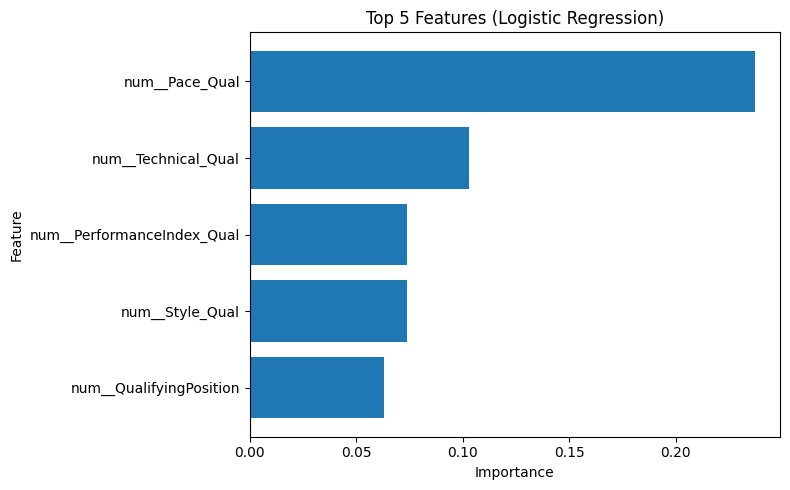

In [31]:

import matplotlib.pyplot as plt
import pandas as pd
import re

# Parse "feature (importance)" pairs from the result string
feature_str = result["Top 10 Features"]

if isinstance(feature_str, str) and feature_str != "N/A":
    # Use regex to extract (feature, importance)
    pattern = r"([\w\-]+)\s*\(([-+]?\d*\.\d+|\d+)\)"
    parsed = re.findall(pattern, feature_str)

    if parsed:
        top_features_df = pd.DataFrame(parsed, columns=["Feature", "Importance"])
        top_features_df["Importance"] = top_features_df["Importance"].astype(float)

        # Select top 5
        top5 = top_features_df.head(5)

        # Plot
        plt.figure(figsize=(8, 5))
        plt.barh(top5["Feature"], top5["Importance"])
        plt.xlabel("Importance")
        plt.ylabel("Feature")
        plt.title("Top 5 Features (Logistic Regression)")
        plt.gca().invert_yaxis()
        plt.tight_layout()
        plt.show()
    else:
        print("⚠️ Could not parse feature importance string.")
else:
    print("⚠️ No feature importance data available.")


MERGING DATA FOR PLOTTING

In [32]:
data_raw.head()

,Timestamp,driver_code,Consistency_Race,Style_Race,Technical_Race,Pace_Race,PerformanceIndex_Race,Consistency_Qual,Style_Qual,Technical_Qual,...,Finish_pct,Accident_pct,Collision_pct,Damage Related_pct,DNF_pct,Race_Complexity_Score,Safety_Index,mechanical_faults,avg_stops_per_car_race,avg_pitstop_ms
0,11/11/2025 20:10,HAM,0.487,0.870,0.308,0.885,0.637,0.254,0.203,0.403,...,84.416,3.896,11.688,0.000,15.584,0.492,0.352,0.000,1.892,160011.280
1,11/11/2025 20:10,LEC,0.500,0.204,0.574,0.500,0.444,0.000,0.200,0.305,...,84.416,3.896,11.688,0.000,15.584,0.492,0.352,0.000,1.892,160011.280
2,11/11/2025 20:10,NOR,0.664,0.549,0.326,1.000,0.635,0.169,0.500,0.417,...,84.416,3.896,11.688,0.000,15.584,0.492,0.352,0.000,1.892,160011.280
3,11/11/2025 20:10,PIA,0.459,0.382,0.709,0.962,0.628,0.341,0.203,0.190,...,84.416,3.896,11.688,0.000,15.584,0.492,0.352,0.000,1.892,160011.280
4,11/11/2025 20:10,RUS,0.480,0.532,0.403,0.654,0.517,0.464,0.792,0.232,...,84.416,3.896,11.688,0.000,15.584,0.492,0.352,0.000,1.892,160011.280


In [31]:
test_results.head()

,cat__team_Alpine Renault,cat__team_Aston Martin Aramco Mercedes,cat__team_Ferrari,cat__team_McLaren,cat__team_McLaren Mercedes,cat__team_McLaren Renault,cat__team_Mercedes,cat__team_Red Bull Racing,cat__team_Red Bull Racing Honda,cat__team_Red Bull Racing Honda RBPT,...,num__Damage Related_pct,num__DNF_pct,num__Race_Complexity_Score,num__Safety_Index,num__mechanical_faults,num__avg_stops_per_car_race,num__avg_pitstop_ms,Actual,Predicted,Predicted_Prob
73,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,...,0.000,13.725,0.415,0.448,0.000,1.892,160011.280,0,1,0.508
19,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,...,0.000,5.882,0.278,0.664,0.000,1.892,160011.280,0,0,0.993
116,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,...,0.000,14.400,0.478,0.378,0.000,1.892,160011.280,1,1,0.719
67,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,...,0.000,11.458,0.369,0.516,0.000,1.892,160011.280,0,0,0.520
94,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,...,0.000,12.621,0.392,0.481,0.000,1.892,160011.280,1,1,0.596


In [33]:
test_results = test_results.rename(columns={
    'num__PerformanceIndex_Qual': 'PerformanceIndex_Qual',
    # 'race_name': 'GrandPrix',
    # 'season': 'Year'
})

final_results = pd.merge(
    test_results,
    data_raw[['PerformanceIndex_Qual','driver_code', 'GrandPrix', 'year','team',"RaceFinishPosition"]],  # keep only relevant keys
    on=['PerformanceIndex_Qual'],
    how='left'   # keeps all rows from test_results
)

final_results.head()

,cat__team_Alpine Renault,cat__team_Aston Martin Aramco Mercedes,cat__team_Ferrari,cat__team_McLaren,cat__team_McLaren Mercedes,cat__team_McLaren Renault,cat__team_Mercedes,cat__team_Red Bull Racing,cat__team_Red Bull Racing Honda,cat__team_Red Bull Racing Honda RBPT,...,num__avg_stops_per_car_race,num__avg_pitstop_ms,Actual,Predicted,Predicted_Prob,driver_code,GrandPrix,year,team,RaceFinishPosition
0,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,...,1.892,160011.280,0,0,0.638,PIA,Canadian Grand Prix,2025,McLaren,4.000
1,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,...,1.892,160011.280,0,0,0.984,SAI,Chinese Grand Prix,2025,Williams,10.000
2,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,...,1.892,160011.280,1,1,0.715,RUS,Singapore Grand Prix,2025,Mercedes,1.000
3,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,...,1.892,160011.280,0,0,0.881,RUS,Spanish Grand Prix,2025,Mercedes,4.000
4,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,...,1.892,160011.280,2,2,0.522,PIA,Hungarian Grand Prix,2025,McLaren,2.000


PLOTTING Test Results

In [34]:
data_results_v2=pd.read_csv(r"C:\Enzo_Files\AIM Data Science\AIM_Sharing\ML1_Final_Project\F1_Model_Results_v2.csv")
# data_results_v2 = final_results.copy()
data_results_v2.columns

Index(['cat__Direction_Anti-clockwise', 'cat__Direction_Clockwise',
       'num__Consistency_Qual', 'num__Style_Qual', 'num__Technical_Qual',
       'num__Pace_Qual', 'PerformanceIndex_Qual', 'num__Round', 'num__year',
       'num__QualifyingPosition', 'num__driver_points', 'num__team_points',
       'num__Laps', 'num__Corners', 'num__Circuit length (km)',
       'num__Race distance (km)', 'num__Accident', 'num__Collision',
       'num__Damage Related', 'num__Finish', 'num__Total_Entries',
       'num__Finish_pct', 'num__Accident_pct', 'num__Collision_pct',
       'num__Damage Related_pct', 'num__DNF_pct', 'num__Race_Complexity_Score',
       'num__Safety_Index', 'num__mechanical_faults',
       'num__avg_stops_per_car_race', 'num__avg_pitstop_ms', 'Actual',
       'Predicted', 'Predicted_Prob', 'driver_code', 'GrandPrix', 'year',
       'team', 'RaceFinishPosition'],
      dtype='object')

In [35]:
data_results_v2_2 = data_results_v2[[
    'PerformanceIndex_Qual',
    'num__Round',
    'num__year',
    'num__QualifyingPosition',
    # 'num__driver_points',
    # 'num__team_points',
    'num__Finish_pct',
    'num__Accident_pct',
    'num__Collision_pct',
    'num__Race_Complexity_Score',
    'num__Safety_Index',
    'Actual',
    'Predicted',
    'Predicted_Prob',
    'driver_code',
    'GrandPrix',
    'year',
    'team',
    'RaceFinishPosition'
]]

data_results_v2_2.head()


,PerformanceIndex_Qual,num__Round,num__year,num__QualifyingPosition,num__Finish_pct,num__Accident_pct,num__Collision_pct,num__Race_Complexity_Score,num__Safety_Index,Actual,Predicted,Predicted_Prob,driver_code,GrandPrix,year,team,RaceFinishPosition
0,0.541,10.000,2025.000,3.000,86.275,2.941,10.784,0.415,0.448,0,1,0.651,PIA,Canadian Grand Prix,2025,McLaren,4.000
1,0.525,2.000,2025.000,15.000,94.118,1.176,4.706,0.278,0.664,0,0,0.994,SAI,Chinese Grand Prix,2025,Williams,10.000
2,0.840,18.000,2025.000,1.000,85.600,6.400,8.000,0.478,0.378,1,1,0.549,RUS,Singapore Grand Prix,2025,Mercedes,1.000
3,0.579,9.000,2025.000,4.000,88.542,1.042,10.417,0.369,0.516,0,0,0.600,RUS,Spanish Grand Prix,2025,Mercedes,4.000
4,0.663,14.000,2025.000,2.000,87.379,3.883,8.738,0.392,0.481,1,1,0.689,PIA,Hungarian Grand Prix,2025,McLaren,2.000


In [36]:
import plotly.graph_objects as go

# Sort by round so races appear in order
data_results_v2_2 = data_results_v2_2.sort_values(by='num__Round')

# Unique drivers
drivers = data_results_v2_2['driver_code'].unique()

# Create figure
fig = go.Figure()

# One trace per driver
for driver in drivers:
    driver_data = data_results_v2_2[data_results_v2_2['driver_code'] == driver]
    fig.add_trace(go.Scatter(
        x=driver_data['GrandPrix'],
        y=driver_data['RaceFinishPosition'],
        mode='markers+lines+text',
        name=driver,
        text=driver_data['RaceFinishPosition'],
        textposition='top center',
        marker=dict(size=10, line=dict(width=1, color='black')),
        hovertemplate=(
            "<b>%{x}</b><br>"
            "Driver: <b>%{customdata[0]}</b><br>"
            "Team: %{customdata[1]}<br>"
            "Round: %{customdata[2]}<br>"
            "Finish: %{y}<br>"
            "Predicted: %{customdata[3]:.3f}<br>"
            "Actual: %{customdata[4]:.3f}<br>"
            "Prob: %{customdata[5]:.3f}<extra></extra>"
        ),
        customdata=np.stack([
            driver_data['driver_code'],
            driver_data['team'],
            driver_data['num__Round'],
            driver_data['Predicted'],
            driver_data['Actual'],
            driver_data['Predicted_Prob']
        ], axis=-1)
    ))

# Reverse Y-axis (P1 at the top)
fig.update_yaxes(
    autorange='reversed',
    title_text='Race Finish Position'
)

# Grand Prix on X-axis
fig.update_xaxes(
    title_text='Grand Prix',
    tickangle=45,
    tickmode='array',
    tickvals=data_results_v2_2['GrandPrix'].unique()
)

# ============================================================
# 🏆 Add podium line at position = 3
# ============================================================
fig.add_shape(
    type='line',
    x0=-0.5,  # extend slightly before first point
    x1=len(data_results_v2_2['GrandPrix'].unique()) - 0.5,
    y0=3,
    y1=3,
    line=dict(color='red', width=3, dash='dash'),
    xref='x',
    yref='y'
)

# Add annotation label
fig.add_annotation(
    xref='paper',
    yref='y',
    x=1.02,
    y=3,
    # text='🏆 Podium Cutoff (P3)',
    showarrow=False,
    font=dict(color='gold', size=12)
)

# Layout styling
fig.update_layout(
    title='🏁 Race Finish Position by Grand Prix (Colored by Driver)',
    template='plotly_white',
    hovermode='closest',
    legend_title_text='Driver',
    title_x=0.5,
    height=700,
)

fig.show()


In [37]:
import plotly.graph_objects as go
import numpy as np

# Sort data for chronological order
data_results_v2_2 = data_results_v2_2.sort_values(by='num__Round')

# Add a boolean column for correct predictions
data_results_v2_2['Correct'] = np.where(
    data_results_v2_2['Actual'] == data_results_v2_2['Predicted'], 1, 0
)

# Map colors: green = correct, red = wrong
data_results_v2_2['Color'] = np.where(
    data_results_v2_2['Correct'] == 1, "#13de3c", 'red'
)

# Get list of unique drivers
drivers = data_results_v2_2['driver_code'].unique()

# Create figure
fig = go.Figure()

# Add one trace per driver
for driver in drivers:
    driver_data = data_results_v2_2[data_results_v2_2['driver_code'] == driver]
    fig.add_trace(go.Scatter(
        x=driver_data['GrandPrix'],
        y=driver_data['RaceFinishPosition'],
        mode='markers+lines',
        name=driver,
        text=driver_data['RaceFinishPosition'],
        textposition='top center',
        marker=dict(
            size=15,
            color=driver_data['Color'],      # red/green based on correctness
            line=dict(width=1, color='black')
        ),
        hovertemplate=(
            "<b>%{x}</b><br>"
            "Driver: <b>%{customdata[0]}</b><br>"
            "Team: %{customdata[1]}<br>"
            "Round: %{customdata[2]}<br>"
            "Finish: %{y}<br>"
            "Predicted: %{customdata[3]:.3f}<br>"
            "Actual: %{customdata[4]:.3f}<br>"
            "<b>Correct:</b> %{customdata[5]}<br>"
            "Prob: %{customdata[6]:.3f}<extra></extra>"
        ),
        customdata=np.stack([
            driver_data['driver_code'],
            driver_data['team'],
            driver_data['num__Round'],
            driver_data['Predicted'],
            driver_data['Actual'],
            np.where(driver_data['Correct'] == 1, '✅ Yes', '❌ No'),
            driver_data['Predicted_Prob']
        ], axis=-1)
    ))

# Reverse Y-axis so P1 is on top
fig.update_yaxes(
    autorange='reversed',
    title_text='Race Finish Position'
)

# Set Grand Prix labels on X-axis
fig.update_xaxes(
    title_text='Grand Prix',
    tickangle=45,
    tickmode='array',
    tickvals=data_results_v2_2['GrandPrix'].unique()
)

# Add Podium line (P3)
fig.add_shape(
    type='line',
    x0=-0.5,
    x1=len(data_results_v2_2['GrandPrix'].unique()) - 0.5,
    y0=3,
    y1=3,
    line=dict(color='red', width=3, dash='dash'),
    xref='x',
    yref='y'
)

# Layout styling
fig.update_layout(
    title='🏁 Race Finish Position by Grand Prix (Colored by Prediction Accuracy)',
    template='plotly_white',
    hovermode='closest',
    legend_title_text='Driver',
    title_x=0.5,
    height=700,
)

fig.write_html("F1_Main_graph.html")
fig.show()



COMPARING with Benchmark

In [39]:
data_check

,PerformanceIndex_Qual,num__Round,num__year,num__QualifyingPosition,num__Finish_pct,num__Accident_pct,num__Collision_pct,num__Race_Complexity_Score,num__Safety_Index,Actual,Predicted,Predicted_Prob,driver_code,GrandPrix,year,team,RaceFinishPosition,Correct,Color,Qual_prediction
1,0.525,2.000,2025.000,15.000,94.118,1.176,4.706,0.278,0.664,0,0,0.994,SAI,Chinese Grand Prix,2025,Williams,10.000,1,#13de3c,0
15,0.578,2.000,2025.000,2.000,94.118,1.176,4.706,0.278,0.664,1,1,0.506,RUS,Chinese Grand Prix,2025,Mercedes,3.000,1,#13de3c,1
59,0.328,2.000,2025.000,3.000,94.118,1.176,4.706,0.278,0.664,1,1,0.660,NOR,Chinese Grand Prix,2025,McLaren,2.000,1,#13de3c,1
35,0.462,2.000,2025.000,6.000,94.118,1.176,4.706,0.278,0.664,0,0,0.813,LEC,Chinese Grand Prix,2025,Ferrari,18.000,1,#13de3c,0
122,0.818,2.000,2025.000,4.000,94.118,1.176,4.706,0.278,0.664,0,0,0.572,VER,Chinese Grand Prix,2025,Red Bull Racing,4.000,1,#13de3c,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87,0.407,19.000,2025.000,6.000,86.842,3.509,8.772,0.463,0.405,0,0,0.823,PIA,United States Grand Prix,2025,McLaren,5.000,1,#13de3c,0
64,0.600,19.000,2025.000,5.000,86.842,3.509,8.772,0.463,0.405,0,0,0.923,HAM,United States Grand Prix,2025,Ferrari,4.000,1,#13de3c,0
68,0.507,19.000,2025.000,2.000,86.842,3.509,8.772,0.463,0.405,1,1,0.650,NOR,United States Grand Prix,2025,McLaren,2.000,1,#13de3c,1
34,0.702,19.000,2025.000,4.000,86.842,3.509,8.772,0.463,0.405,0,0,0.791,RUS,United States Grand Prix,2025,Mercedes,6.000,1,#13de3c,0


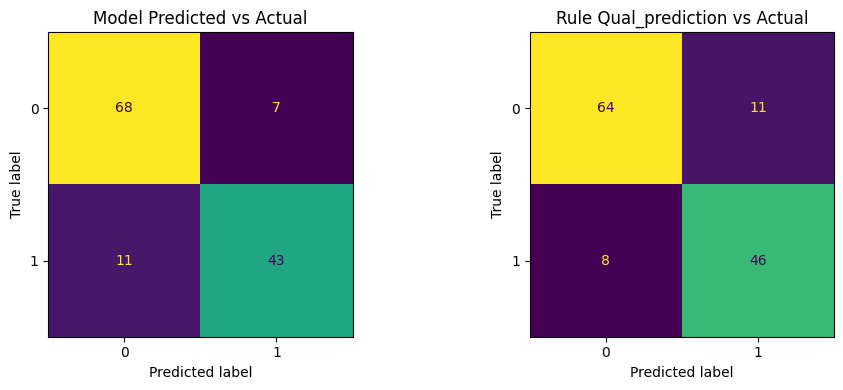

       accuracy  precision  recall    f1
Model     0.860      0.860   0.796 0.827
Rule      0.853      0.807   0.852 0.829


In [38]:
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, accuracy_score, precision_score, recall_score, f1_score
import matplotlib.pyplot as plt

data_check=data_results_v2_2

data_check["Qual_prediction"] = (data_check["num__QualifyingPosition"] <= 3).astype(int)


data_check.head()

# If needed: ensure binary ints (adjust mapping as appropriate)
y_true = pd.to_numeric(data_check["Actual"], errors="coerce").astype(int)

# If Predicted is probabilities, threshold at 0.5; otherwise cast to int
pred_raw = data_check["Predicted"]
y_pred = ((pred_raw >= 0.5).astype(int)
          if np.issubdtype(pred_raw.dtype, np.number) and not np.issubdtype(pred_raw.dtype, np.integer)
          else pd.to_numeric(pred_raw, errors="coerce").astype(int))

y_rule = pd.to_numeric(data_check["Qual_prediction"], errors="coerce").astype(int)

# Confusion matrices
cm_model = confusion_matrix(y_true, y_pred, labels=[0, 1])
cm_rule  = confusion_matrix(y_true, y_rule, labels=[0, 1])

fig, axes = plt.subplots(1, 2, figsize=(10, 4))
ConfusionMatrixDisplay(cm_model, display_labels=[0,1]).plot(ax=axes[0], colorbar=False)
axes[0].set_title("Model Predicted vs Actual")
ConfusionMatrixDisplay(cm_rule, display_labels=[0,1]).plot(ax=axes[1], colorbar=False)
axes[1].set_title("Rule Qual_prediction vs Actual")
plt.tight_layout()
plt.show()

# Summary metrics
summary = pd.DataFrame({
    "accuracy":  [accuracy_score(y_true, y_pred), accuracy_score(y_true, y_rule)],
    "precision": [precision_score(y_true, y_pred, zero_division=0), precision_score(y_true, y_rule, zero_division=0)],
    "recall":    [recall_score(y_true, y_pred, zero_division=0), recall_score(y_true, y_rule, zero_division=0)],
    "f1":        [f1_score(y_true, y_pred, zero_division=0), f1_score(y_true, y_rule, zero_division=0)],
}, index=["Model", "Rule"])
print(summary)





Optuna Attempt

In [ ]:
# ============================================================
# 🏎️ Optuna Training Framework Setup (Corrected)
# ============================================================

import time
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold, cross_val_score
import optuna
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import make_pipeline
import xgboost as xgb

# ============================================================
# === Configuration ===
# ============================================================

cv = KFold(n_splits=5, shuffle=True, random_state=42)

# ============================================================
# === Helper functions ===
# ============================================================

def _final_estimator(est):
    """Return final estimator from pipeline or model."""
    return list(est.named_steps.values())[-1] if hasattr(est, "named_steps") else est

def _top_feature(estimator, X):
    """Return most important feature based on coefficients or importances."""
    est = _final_estimator(estimator)
    try:
        if hasattr(est, "feature_importances_"):
            idx = int(np.argmax(est.feature_importances_))
            return X.columns[idx]
        if hasattr(est, "coef_"):
            coef = np.asarray(est.coef_)
            if coef.ndim > 1:
                coef = np.mean(np.abs(coef), axis=0)
            idx = int(np.argmax(np.abs(coef)))
            return X.columns[idx]
    except Exception:
        pass
    return "NA"

# ============================================================
# === Core Training Function Template (Optuna) ===
# ============================================================

def _train_model(model_name, model, search_space, X, y, X_test, y_test, n_trials=60):
    """Unified Optuna-based optimization + test evaluation."""
    t0 = time.time()

    # Mord model (no params)
    if model_name == "Ordinal Logistic Regression (mord)":
        scores = cross_val_score(model, X, y, cv=cv, scoring="accuracy", n_jobs=-1)
        model.fit(X, y)
        test_score = model.score(X_test, y_test)
        return [
            model_name,
            scores.mean(),
            "{}",
            _top_feature(model, X),
            test_score,
            time.time() - t0,
        ]

    # === Define Optuna objective ===
    def objective(trial):
        params = {}
        for param, space in search_space.items():
            if len(space) == 3 and space[2] == "int":
                params[param] = trial.suggest_int(param, space[0], space[1])
            elif len(space) == 3 and space[2] == "log":
                params[param] = trial.suggest_float(param, space[0], space[1], log=True)
            elif len(space) == 2:
                params[param] = trial.suggest_float(param, space[0], space[1])
            elif isinstance(space, list):
                params[param] = trial.suggest_categorical(param, space)
            else:
                raise ValueError(f"Invalid search space for {param}: {space}")

        est = model.set_params(**params)
        score = cross_val_score(est, X, y, cv=cv, scoring="accuracy", n_jobs=-1).mean()
        return score

    # === Run Optuna study ===
    study = optuna.create_study(direction="maximize", study_name=model_name)
    study.optimize(objective, n_trials=n_trials, show_progress_bar=True)

    # === Train best model on full training set ===
    best_params = study.best_params
    model.set_params(**best_params)
    model.fit(X, y)
    test_score = model.score(X_test, y_test)

    return [
        model_name,
        study.best_value,
        str(best_params),
        _top_feature(model, X),
        test_score,
        time.time() - t0,
    ]

# ============================================================
# === Example Model: XGBoost
# ============================================================

def train_xgb(X, y, X_test, y_test):
    model = xgb.XGBClassifier(
        random_state=42,
        nthread=-1,
        tree_method="hist",
        use_label_encoder=False,
        eval_metric="logloss",
    )

    # ✅ Correct Optuna-style search space
    search = {
        "n_estimators": (100, 1000, "int"),
        "learning_rate": (1e-3, 0.3, "log"),
        "max_depth": (2, 10, "int"),
        "subsample": (0.5, 1.0),
        "colsample_bytree": (0.5, 1.0),
        "reg_lambda": (1e-3, 15.0, "log"),
        "reg_alpha": (1e-6, 1.0, "log"),
    }

    return _train_model("XGBoost (Optuna)", model, search, X, y, X_test, y_test, n_trials=60)


def train_rf(X, y, X_test, y_test):
    model = RandomForestClassifier(random_state=42, n_jobs=-1)
    search = {
        "n_estimators": (80, 200, "int"),
        "max_depth": (2, 20, "int"),
        "max_features": ["sqrt", "log2"],
        "bootstrap": [True, False],
    }
    return _train_model("Random Forest (Optuna)", model, search, X, y, X_test, y_test,n_trials=60)


In [ ]:
# XGBoost: encode y only for XGB
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train_val_enc = le.fit_transform(y_train_val)
y_test_enc = le.transform(y_test)

# results.append(train_xgb(X_train_val, y_train_val_enc, X_test, y_test_enc))
# print("✅ done - XGBoost")
# ==========================================
# Combine and Display Results
# ==========================================
df = pd.DataFrame(
    results,
    columns=['Model', 'CV Accuracy', 'Best Params', 'Top Feature', 'Test Accuracy', 'Runtime (s)']
)

# Sort by best CV Accuracy
df = df.sort_values('CV Accuracy', ascending=False).reset_index(drop=True)

print("\n=== Final Model Performance Summary ===")
display(df)

[I 2025-11-12 19:25:35,615] A new study created in memory with name: Random Forest (Optuna)


  0%|          | 0/60 [00:00<?, ?it/s]

[W 2025-11-12 19:25:35,620] Trial 0 failed with parameters: {'n_estimators': 96, 'max_depth': 17} because of the following error: ValueError("`low <= high` must hold, but got (low='sqrt', high='log2').").
Traceback (most recent call last):
  File "c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\optuna\study\_optimize.py", line 205, in _run_trial
    value_or_values = func(trial)
  File "C:\Users\Enzo\AppData\Local\Temp\ipykernel_21896\744536519.py", line 76, in objective
    params[param] = trial.suggest_float(param, space[0], space[1])
                    ~~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\optuna\trial\_trial.py", line 162, in suggest_float
    distribution = FloatDistribution(low, high, log=log, step=step)
  File "c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\optuna\distributions.py", line 146, in __init__
    raise ValueError(f"`low <= high` m

ValueError: `low <= high` must hold, but got (low='sqrt', high='log2').

Comparing with benchmark

In [5]:
data_results_v2=pd.read_csv(r"C:\Enzo_Files\AIM Data Science\AIM_Sharing\ML1_Final_Project\F1_Model_Results_v2.csv")
data_results_v2


,cat__Direction_Anti-clockwise,cat__Direction_Clockwise,num__Consistency_Qual,num__Style_Qual,num__Technical_Qual,num__Pace_Qual,PerformanceIndex_Qual,num__Round,num__year,num__QualifyingPosition,...,num__avg_stops_per_car_race,num__avg_pitstop_ms,Actual,Predicted,Predicted_Prob,driver_code,GrandPrix,year,team,RaceFinishPosition
0,0.0,1.0,0.000000,0.500922,0.724857,0.937500,0.540820,10.0,2025.0,3.0,...,1.89162,160011.280215,0,1,0.651449,PIA,Canadian Grand Prix,2025,McLaren,4.0
1,0.0,1.0,0.987866,0.285797,0.325009,0.500000,0.524668,2.0,2025.0,15.0,...,1.89162,160011.280215,0,0,0.994496,SAI,Chinese Grand Prix,2025,Williams,10.0
2,1.0,0.0,0.988921,0.894190,0.476461,1.000000,0.839893,18.0,2025.0,1.0,...,1.89162,160011.280215,1,1,0.548845,RUS,Singapore Grand Prix,2025,Mercedes,1.0
3,0.0,1.0,0.574922,0.441937,0.388619,0.911765,0.579311,9.0,2025.0,4.0,...,1.89162,160011.280215,0,0,0.599718,RUS,Spanish Grand Prix,2025,Mercedes,4.0
4,0.0,1.0,0.957205,0.261564,0.475135,0.958333,0.663059,14.0,2025.0,2.0,...,1.89162,160011.280215,1,1,0.688986,PIA,Hungarian Grand Prix,2025,McLaren,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
124,0.0,1.0,0.088310,0.157759,0.308822,0.781250,0.334035,10.0,2025.0,8.0,...,1.89162,160011.280215,0,0,0.858056,LEC,Canadian Grand Prix,2025,Ferrari,5.0
125,0.0,1.0,0.999648,0.500000,0.526028,0.875000,0.725169,16.0,2025.0,4.0,...,1.89162,160011.280215,0,0,0.737762,LEC,Italian Grand Prix,2025,Ferrari,4.0
126,0.0,1.0,0.246595,0.162259,0.326837,0.857143,0.398208,2.0,2025.0,5.0,...,1.89162,160011.280215,0,0,0.815899,HAM,Chinese Grand Prix,2025,Ferrari,19.0
127,0.0,1.0,0.636972,0.464888,0.372188,1.000000,0.618512,14.0,2025.0,1.0,...,1.89162,160011.280215,0,0,0.503637,LEC,Hungarian Grand Prix,2025,Ferrari,4.0


# OLD CODE

In [133]:
Number_trials = 10     # number of repeated k-fold runs. Hihger Makes Run Longer
n_splits = 3  

def train_knn(X, y):
    score_train = []
    score_test = []

    # KNN GRID SEARCH SETTINGS ==============================
    neighbors_settings = np.arange(1, 10, 1)  # 1,3,5,7,9,11

    # single stratified k-fold (faster; no random seeds)
    kf = KFold(n_splits=n_splits, shuffle=True)

    # store per-fold accuracies for each k
    acc_train = np.zeros((len(neighbors_settings), n_splits))
    acc_test = np.zeros((len(neighbors_settings), n_splits))

    for fold_idx, (train_index, val_index) in enumerate(kf.split(X, y)):
        X_train, X_val = X.iloc[train_index], X.iloc[val_index]
        y_train, y_val = y.iloc[train_index], y.iloc[val_index]

        scaler = MinMaxScaler()
        X_train = scaler.fit_transform(X_train)
        X_val = scaler.transform(X_val)

        for i, n_neighbors in enumerate(neighbors_settings):
            clf = KNeighborsClassifier(n_neighbors=n_neighbors, n_jobs=-1)
            clf.fit(X_train, y_train)
            acc_train[i, fold_idx] = clf.score(X_train, y_train)
            acc_test[i, fold_idx] = clf.score(X_val, y_val)

    # mean over folds
    score_train.append(acc_train.mean(axis=1))
    score_test.append(acc_test.mean(axis=1))
    lahat_training = np.array(score_train)
    lahat_test = np.array(score_test)
    score = lahat_test.mean(axis=0)
    run_time = (time.time() - start_time)
    best_n = neighbors_settings[np.argmax(score)]
    return ['kNN', np.amax(score), f'N_Neighbor = {best_n}', 'NA', run_time]

start_time = time.time()
a = train_knn(X_train_val, y_train_val)
print(a)
print("%s seconds" % a[4])

['kNN', np.float64(0.9301754385964912), 'N_Neighbor = 9', 'NA', 11.075953006744385]
11.075953006744385 seconds


In [150]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold

pipe_knn = make_pipeline(MinMaxScaler(), KNeighborsClassifier())

param_grid = {
    'kneighborsclassifier__n_neighbors': [3,5,7,9,11],
    'kneighborsclassifier__weights': ['uniform','distance'],
    'kneighborsclassifier__p': [1,2],  # Manhattan vs Euclidean
}

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
grid = GridSearchCV(pipe_knn, param_grid, cv=cv, n_jobs=-1)
grid.fit(X_train, y_train)

print(grid.best_params_)
print("CV best score:", grid.best_score_)
print("Test accuracy:", grid.score(X_test, y_test))


{'kneighborsclassifier__n_neighbors': 7, 'kneighborsclassifier__p': 1, 'kneighborsclassifier__weights': 'uniform'}
CV best score: 0.9313157894736843
Test accuracy: 0.928


In [188]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.model_selection import RandomizedSearchCV, StratifiedKFold
from scipy.stats import randint, uniform, loguniform
import numpy as np

# ===== KNN with Randomized Search =====
pipe_knn = make_pipeline(MinMaxScaler(), KNeighborsClassifier())

param_distributions_knn = {
    'kneighborsclassifier__n_neighbors': randint(1, 51),             # 1..50
    'kneighborsclassifier__weights': ['uniform', 'distance'],
    'kneighborsclassifier__p': [1, 2],                                # manhattan vs euclidean
    'kneighborsclassifier__leaf_size': randint(10, 60),
    # Optional: try different algorithms
    'kneighborsclassifier__algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute']
}

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
rnd_knn = RandomizedSearchCV(
    estimator=pipe_knn,
    param_distributions=param_distributions_knn,
    n_iter=50,                   # try fewer/more for speed vs. thoroughness
    scoring='accuracy',          # change to 'f1_macro', etc., if imbalanced
    cv=cv,
    random_state=42,
    n_jobs=-1,
    verbose=1
)

rnd_knn.fit(X_train, y_train)
print("KNN best params:", rnd_knn.best_params_)
print("KNN CV best score:", rnd_knn.best_score_)
print("KNN Test accuracy:", rnd_knn.score(X_test, y_test))


# ===== SVM with Randomized Search =====
pipe_svm = make_pipeline(MinMaxScaler(), SVC(probability=False))

param_distributions_svm = {
    'svc__C': loguniform(1e-3, 1e3),     # log-uniform search over C
    'svc__gamma': loguniform(1e-4, 1e0), # RBF kernel gamma
    'svc__kernel': ['rbf']               # keep 'rbf' for this search; add 'linear' if desired
    # If you include 'linear', drop 'gamma' or guard it conditionally
}

rnd_svm = RandomizedSearchCV(
    estimator=pipe_svm,
    param_distributions=param_distributions_svm,
    n_iter=40,
    scoring='accuracy',
    cv=cv,
    random_state=42,
    n_jobs=-1,
    verbose=1
)

rnd_svm.fit(X_train, y_train)
print("SVM best params:", rnd_svm.best_params_)
print("SVM CV best score:", rnd_svm.best_score_)
print("SVM Test accuracy:", rnd_svm.score(X_test, y_test))


Fitting 5 folds for each of 50 candidates, totalling 250 fits
KNN best params: {'kneighborsclassifier__algorithm': 'kd_tree', 'kneighborsclassifier__leaf_size': 20, 'kneighborsclassifier__n_neighbors': 11, 'kneighborsclassifier__p': 2, 'kneighborsclassifier__weights': 'uniform'}
KNN CV best score: 0.7864506627393224
KNN Test accuracy: 0.7631578947368421
Fitting 5 folds for each of 40 candidates, totalling 200 fits
SVM best params: {'svc__C': np.float64(4.0428727350273315), 'svc__gamma': np.float64(0.06796578090758151), 'svc__kernel': 'rbf'}
SVM CV best score: 0.8192720387123922
SVM Test accuracy: 0.8421052631578947


Summary

In [127]:
cols = ['Machine Learning Method', 'Validation Accuracy', 'Best Parameter', 'Top Predictor Variable', 'Run Time']
df2 = pd.DataFrame(columns=cols)

df2.loc[0] = a
# df2.loc[1] = b
# df2.loc[2] = c
# df2.loc[3] = d
# df2.loc[4] = e
# df2.loc[5] = f
# df2.loc[6] = g

df2

,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,kNN,0.930175,N_Neighbor = 11,NA,90.99879


Old Code

In [ ]:
# Number_trials = 3
Number_trials = 3     # number of repeated k-fold runs
n_splits = 5        # number of folds for KFold

def train_knn(X, y):
    score_train = []
    score_test = []

    for seed in range(Number_trials):
        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.20, random_state=seed)
        scaler = MinMaxScaler()
        X_train = scaler.fit_transform(X_train)
        X_val = scaler.transform(X_val)

        # avoid asking for more neighbors than training samples
        # max_k = min(70, len(X_train))
        neighbors_settings = np.arange(1, 12,2)

        acc_train = []
        acc_test = []

        for n_neighbors in neighbors_settings:
            clf = KNeighborsClassifier(n_neighbors=n_neighbors)
            clf.fit(X_train, y_train)
            acc_train.append(clf.score(X_train, y_train))
            acc_test.append(clf.score(X_val, y_val))

        score_train.append(acc_train)
        score_test.append(acc_test)

    score = np.mean(score_test, axis=0)
    run_time = (time.time() - start_time)
    return ['kNN', np.amax(score), f'N_Neighbor = {np.argmax(score)+1}', 'NA', run_time]


def train_logistic(X, y, reg):
    C = [1e-4, 1e-3, 1e-2, 1e-1, 1e0, 1e1, 1e2, 1e3, 1e4]
    score_train = []
    score_test = []
    weighted_coefs = []

    for seed in range(Number_trials):
        training_accuracy = []
        test_accuracy = []
        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.20, random_state=seed)
        scaler = MinMaxScaler()
        X_train = scaler.fit_transform(X_train)
        X_val = scaler.transform(X_val)

        for alpha_run in C:
            if reg == 'l1':
                lr = LogisticRegression(C=alpha_run, penalty=reg, solver='liblinear', max_iter=1000).fit(X_train, y_train)
            elif reg == 'l2':
                lr = LogisticRegression(C=alpha_run, penalty=reg, solver='lbfgs', max_iter=1000).fit(X_train, y_train)

            training_accuracy.append(lr.score(X_train, y_train))
            test_accuracy.append(lr.score(X_val, y_val))
            weighted_coefs.append(lr.coef_)

        score_train.append(training_accuracy)
        score_test.append(test_accuracy)

    mean_coefs = np.mean(weighted_coefs, axis=0)
    score = np.mean(score_test, axis=0)

    flat_coefs = np.abs(mean_coefs).ravel()[:len(X.columns)]
    top_predictor = X.columns[np.argmax(flat_coefs)]

    abs_mean_coefs = np.abs(mean_coefs[0, :])
    coefs_count = len(abs_mean_coefs)
    fig, ax = plt.subplots(figsize=(3, 3 + coefs_count))
    ax.barh(np.arange(coefs_count), sorted(abs_mean_coefs))
    ax.set_yticks(np.arange(coefs_count))
    ax.set_yticklabels(X.columns[np.argsort(abs_mean_coefs)])
    plt.show()

    run_time = (time.time() - start_time)
    return [f'Logistic ({reg})', np.amax(score),
            f'C = {C[np.argmax(score)]}', top_predictor, run_time]


def train_svm(X, y, reg):
    C = [1e-4, 1e-3, 1e-2, 1e-1, 1e0, 1e1, 1e2, 1e3, 1e4]
    score_train = []
    score_test = []
    weighted_coefs = []

    for seed in range(Number_trials):
        training_accuracy = []
        test_accuracy = []
        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.20, random_state=seed)
        scaler = MinMaxScaler()
        X_train = scaler.fit_transform(X_train)
        X_val = scaler.transform(X_val)
        
        for alpha_run in C:
            if reg == 'l1':
                svc = LinearSVC(C=alpha_run, penalty=reg, loss='squared_hinge', dual=False, max_iter=1000).fit(X_train, y_train)
            elif reg == 'l2':
                svc = LinearSVC(C=alpha_run, penalty=reg, max_iter=1000).fit(X_train, y_train)

            training_accuracy.append(svc.score(X_train, y_train))
            test_accuracy.append(svc.score(X_val, y_val))
            weighted_coefs.append(svc.coef_)

        score_train.append(training_accuracy)
        score_test.append(test_accuracy)

    mean_coefs = np.mean(weighted_coefs, axis=0)
    score = np.mean(score_test, axis=0)

    flat_coefs = np.abs(mean_coefs).ravel()[:len(X.columns)]
    top_predictor = X.columns[np.argmax(flat_coefs)]

    abs_mean_coefs = np.abs(mean_coefs[0, :])
    coefs_count = len(abs_mean_coefs)
    fig, ax = plt.subplots(figsize=(3, 3 + coefs_count))
    ax.barh(np.arange(coefs_count), sorted(abs_mean_coefs))
    ax.set_yticks(np.arange(coefs_count))
    ax.set_yticklabels(X.columns[np.argsort(abs_mean_coefs)])
    plt.show()

    run_time = (time.time() - start_time)
    return [f'Linear SVM ({reg})', np.amax(score),
            f'C = {C[np.argmax(score)]}', top_predictor, run_time]

def train_rf(X, y):
    score_train = []
    score_test = []
    best_params = []
    best_estimators = []

    for seed in range(10):
        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.20, random_state=seed)
        scaler = MinMaxScaler()
        X_train = scaler.fit_transform(X_train)
        X_val = scaler.transform(X_val)
        param_grid = {
        'n_estimators': [50, 100, 150, 200],  # Number of trees in the forest
        'max_depth': list(range(1, 6)),      # Maximum depth of individual trees
        'max_features': ['sqrt'] # Number of features to consider when looking for the best split
        }

        rf = RandomForestClassifier(random_state=0)
        grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose=1)
        grid_search.fit(X_train, y_train)
        score_train.append(grid_search.score(X_train, y_train))
        score_test.append(grid_search.score(X_val, y_val))
        best_params.append(grid_search.best_params_)
        best_estimators.append(grid_search.best_estimator_)

    best_estimator = best_estimators[np.argmax(score_test)]
    score = np.mean(score_test, axis=0)
    run_time = (time.time() - start_time)
    return ['Random Forest', np.amax(score), str(best_params[np.argmax(score_test)]), \
            X.columns[np.argmax(best_estimator.feature_importances_)], run_time]

def train_gbm(X, y):
    score_train = []
    score_test = []
    best_params = []
    best_estimators = []

    for seed in range(10):
        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.20, random_state=seed)
        scaler = MinMaxScaler()
        X_train = scaler.fit_transform(X_train)
        X_val = scaler.transform(X_val)
        param_grid = {
        'n_estimators': [50, 100, 150, 200],  # Number of trees in the forest
        'learning_rate': [0.01, 0.05, 0.1, 0.5, 1]    # Learning Rate
        }

        gbm = GradientBoostingClassifier(random_state=0)
        grid_search = GridSearchCV(estimator=gbm, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose=1)
        grid_search.fit(X_train, y_train)
        score_train.append(grid_search.score(X_train, y_train))
        score_test.append(grid_search.score(X_val, y_val))
        best_params.append(grid_search.best_params_)
        best_estimators.append(grid_search.best_estimator_)

    best_estimator = best_estimators[np.argmax(score_test)]
    score = np.mean(score_test, axis=0)
    run_time = (time.time() - start_time)
    return ['Gradient Boosting Method', np.amax(score), str(best_params[np.argmax(score_test)]), \
            X.columns[np.argmax(best_estimator.feature_importances_)], run_time]


Model run

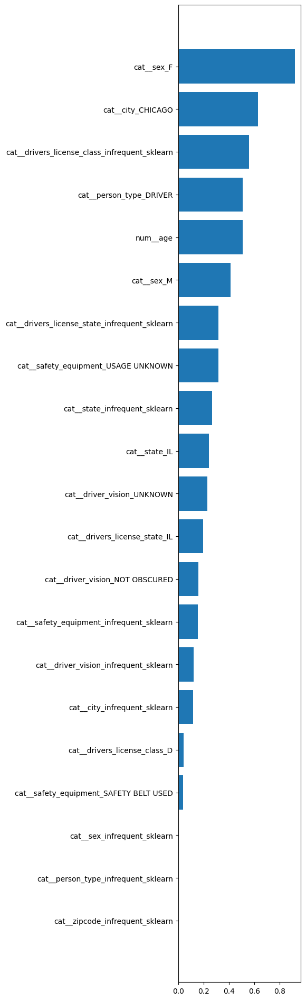

c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\linear_model\_logistic.py:1288: FutureWarning: Using the 'liblinear' solver for multiclass classification is deprecated. An error will be raised in 1.8. Either use another solver which supports the multinomial loss or wrap the estimator in a OneVsRestClassifier to keep applying a one-versus-rest scheme.
  warnings.warn(
c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\linear_model\_logistic.py:1288: FutureWarning: Using the 'liblinear' solver for multiclass classification is deprecated. An error will be raised in 1.8. Either use another solver which supports the multinomial loss or wrap the estimator in a OneVsRestClassifier to keep applying a one-versus-rest scheme.
  warnings.warn(
c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\linear_model\_logistic.py:1288: FutureWarning: Using the 'liblinear' solver for multiclass classification is depreca

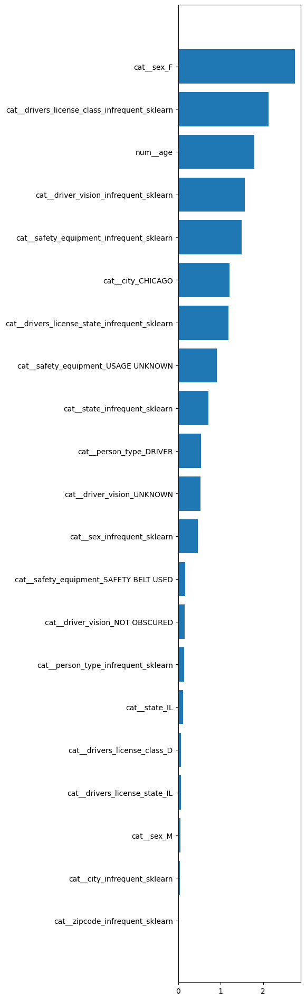

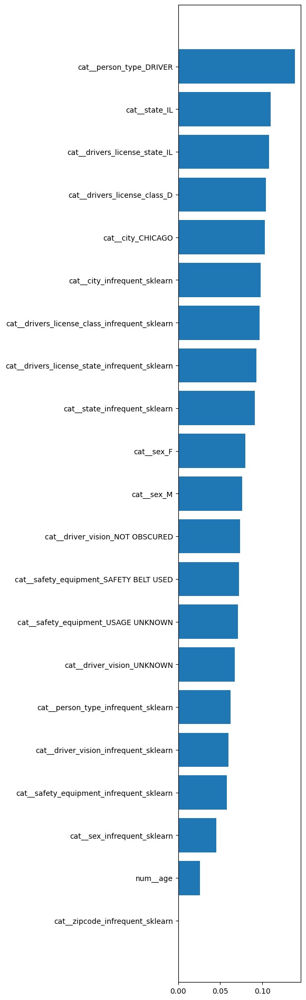

c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\svm\_base.py:1250: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\svm\_base.py:1250: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\svm\_base.py:1250: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\svm\_base.py:1250: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\svm\_base.py:1250: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.w

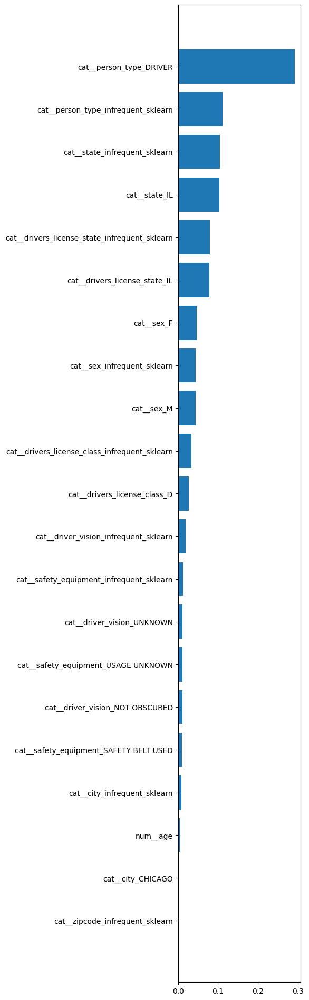

c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Fitting 5 folds for each of 20 candidates, totalling 100 fits


c:\Users\Enzo\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_split.py:811: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


['Logistic (l2)', np.float64(0.925625), 'C = 0.0001', 'cat__sex_F', 1.2462806701660156]
1.2462806701660156 seconds
['Logistic (l1)', np.float64(0.925625), 'C = 0.001', 'cat__sex_F', 9.787163972854614]
9.787163972854614 seconds
['Linear SVM (l2)', np.float64(0.925625), 'C = 0.0001', 'cat__person_type_DRIVER', 0.7866311073303223]
0.7866311073303223 seconds
['Linear SVM (l1)', np.float64(0.925625), 'C = 0.0001', 'cat__person_type_DRIVER', 7.351109266281128]
7.351109266281128 seconds
['Random Forest', np.float64(0.9259999999999999), "{'max_depth': 1, 'max_features': 'sqrt', 'n_estimators': 50}", 'cat__sex_F', 19.16351294517517]
19.16351294517517 seconds
['Gradient Boosting Method', np.float64(0.9257499999999999), "{'learning_rate': 0.01, 'n_estimators': 100}", 'num__age', 121.90318083763123]
121.90318083763123 seconds


In [ ]:

start_time = time.time()
b = train_logistic(X_raw, y, reg='l2')
start_time = time.time()
c = train_logistic(X_raw, y, reg='l1')
start_time = time.time()
d = train_svm(X_raw, y, reg='l2')
start_time = time.time()
e = train_svm(X_raw, y, reg='l1')
start_time = time.time()
f = train_rf(X_raw,y)
start_time = time.time()
g = train_gbm(X_raw,y)


print(b)
print("%s seconds" % b[4])
print(c)
print("%s seconds" % c[4])
print(d)
print("%s seconds" % d[4])
print(e)
print("%s seconds" % e[4])
print(f)
print("%s seconds" % f[4])
print(g)
print("%s seconds" % g[4])


<div class="alert alert-info">
    
### Task 4 - Model Results and Discussion [4 pts]
 1. Display a summary table with the following information: train accuracy, val/test accuracy, best parameter, train time, and top predictor.
 2. Justify what model you will use? At what hyperparameter? Why?
 3. Generate the feature importance plot of your chosen best model.
 4. Give insights on the features deemed important by the best model.    
</div>

In [ ]:
cols = ['Machine Learning Method', 'Test Accuracy', 'Best Parameter', 'Top Predictor Variable', 'Run Time']
df2 = pd.DataFrame(columns=cols)

df2.loc[0] = a
df2.loc[1] = b
df2.loc[2] = c
df2.loc[3] = d
df2.loc[4] = e
df2.loc[5] = f
df2.loc[6] = g

df2

<div class="alert alert-block alert-info">
    
### Task 5 - Business Value Articulation [6 pts]

Understanding the analysis results using any of the machine learning models you have implemented above, write guidelines, criteria, or recommendations for triage to be used by emergency personnel for these types of accidents (2-4 sentences or bullet points). [3 pts]
</div>

Your answer here

</div><div class="alert alert-info">

### Task 6 [2 pts]
 1. Predict on the final test set (last 1000 rows of original data) using your best-performing model.
 2. Show and comment on the resulting confusion matrix.
    
</div>